# Notebook for HI Lyman Series Absorption (v1.1)


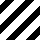
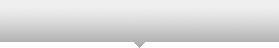
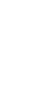
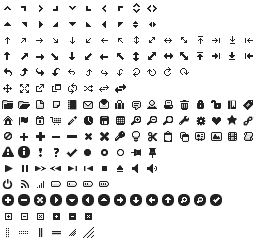
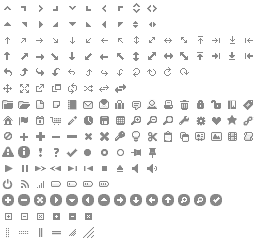
...
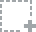
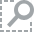
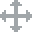
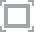
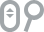

In [1]:
# imports
import copy
import numpy as np

from scipy.special import wofz

from astropy import constants as const
from astropy.cosmology import Planck15
from astropy import units as u

from linetools.lists.linelist import LineList
from linetools.spectralline import AbsLine
from linetools.analysis import voigt as ltav

from bokeh.io import output_notebook, show, hplot, output_file
from bokeh.plotting import figure
from bokeh.models import Range1d

output_notebook()

In [109]:
# For presentation
pwdth = 600  
phght = 300
# For laptop
#pwdth = 800
#phght = 600

## Shift between $\lambda_{\rm rest}$ from Rutherford and $\lambda_{\rm exp}$

$dv = c \frac{d\lambda}{\lambda}$

In [2]:
dv = (1215.6845-1215.6701)/1215.6701 * const.c.to('km/s')
dv

<Quantity 3.5511372659465588 km / s>

## HI Lyman Series transitions

In [3]:
HI_lines = LineList('HI')

In [77]:
HI_lines._data[['name','wrest','f','A','gamma']][-10:]

name,wrest,f,A,gamma
,Angstrom,,1 / s,1 / s
str80,float64,float64,float64,float64
HI 919,919.3513,0.001201,3160000.0,3160000.0
HI 920,920.963,0.001606,4210000.0,4210000.0
HI 923,923.1503,0.002217,5785000.0,5785000.0
HI 926,926.2256,0.003185,8255000.0,8255000.0
HI 930,930.7482,0.004816,12360000.0,12360000.0
HI 937,937.8034,0.007803,19730000.0,24500000.0
HI 949,949.743,0.01395,34370000.0,42040000.0
HI 972,972.5367,0.02901,68190000.0,81270000.0


----

## Line Profiles

### Delta function $\delta(E-E_{jk})$

i.e. an infinite spike at $E = E_{jk}$.

### Natural broadening

#### Breit-Wigner (Lorentzian)

$W_{jk}(E) dE = \frac{[\gamma_j + \gamma_k] dE/h}{
(2\pi/h)^2 [E - E_{jk}]^2 + ([\gamma_j + \gamma_k]/2)^2}$

In [5]:
# Define W_E
def W_E(E, gamma_j, gamma_k, E_jk):
    num = (gamma_j + gamma_k) / const.h
    denom = (2*np.pi/const.h)**2 * (E-E_jk)**2 + ((gamma_j+gamma_k)/2)**2
    return num/denom

In [6]:
# Values for Lya
gamma_j = 0
gamma_k = HI_lines[1215.67]['gamma']  # Simply Ak for Lya
E_jk = (const.h*const.c/HI_lines[1215.67]['wrest']).to('eV')
print("gamma_k={:g}, E_jk={:g}".format(gamma_k, E_jk))

gamma_k=6.265e+08 1 / s, E_jk=10.1988 eV


In [7]:
# Calculate 
dE = 0.001 * E_jk.value
E = np.linspace(E_jk.value-dE, E_jk.value+dE, 10001)*u.eV
WEjk = W_E(E_jk, gamma_j, gamma_k, E_jk).to(1/u.eV)
WE_array = W_E(E, gamma_j, gamma_k, E_jk).to(1/u.eV)

#### Narrowness of the Lorentzian

In [96]:
# Bokeh plot
# Lya
pW = figure(plot_width=600, plot_height=300, title="Breit-Wigner for Lya")
# Data
# Models
pW.line(E.value, WE_array.value/WEjk.value, color='blue', line_width=2, legend='W(E)')

# Axes
pW.xaxis.axis_label = "E [eV]"
pW.yaxis.axis_label = "W(E)/W(Ejk) [1/eV]"
#left, right = 3720., 3860.
#pmock.set(x_range=Range1d(left, right), y_range=Range1d(-0.5e-17, 5e-17))
show(pW)

#### Width

$\Delta E = h (\gamma_j + \gamma_k) / 4 \pi$

Compare with the Heisenberg Uncertainty Principle

In [9]:
DE = const.h * (gamma_j+gamma_k)/4/np.pi
print('DE = {:g}'.format(DE.to('eV')))

DE = 2.06185e-07 eV


#### Lorentzian wings

$\phi_N(\nu) = \frac{2}{\pi} 
                  \;  \frac{(\gamma_j + \gamma_k)/4\pi^2}{(\nu - \nu_{jk})^2
		  + (\gamma_j + \gamma_k)^2 / (4\pi)^2} $

In [10]:
# Define phi_N
def eval_phiN(nu, gamma_j, gamma_k, nu_jk):
    num = (gamma_j + gamma_k) / (4*np.pi)
    denom = np.pi*((nu-nu_jk)**2 + ((gamma_j+gamma_k)**2/(4*np.pi)**2))
    return num/denom

We will use:
    
$\frac{d\nu}{\nu} = \frac{dv}{c}$

to express in terms of velocity.

In [11]:
# Velocity array
relvel = np.linspace(-1000,1000,10001)*u.km/u.s
nu_jk = (E_jk/const.h).to('1/s')
# Define nu
nu = nu_jk*(1+relvel/const.c.to('km/s'))
# Evaluate phiN(nu)
phiN = eval_phiN(nu, gamma_j, gamma_k, nu_jk)
# Express in phiN in velocity space
phi_vN = phiN * nu_jk/const.c.to('km/s')

#### Plot

In [97]:
# Bokeh plot
# Lya
pphiN = figure(plot_width=600, plot_height=300, title="phi_N(v) for Lya")
# Data
# Models
pphiN.line(relvel.value, np.log10(phi_vN.value), color='blue', line_width=2, legend='phi_N(v)')

# Axes
pphiN.xaxis.axis_label = "Relative Velocity (km/s)"
pphiN.yaxis.axis_label = "log10 phi_vN (s/km)"
#left, right = 3720., 3860.
#pmock.set(x_range=Range1d(left, right), y_range=Range1d(-0.5e-17, 5e-17))
show(pphiN)

#### These Lorentzian wings manifest themselves in gas with very large column density

Conveniently, the Universe is full of Hydrogen..

### Doppler Broadening

In [13]:
def eval_phiD(v, b):
    return np.exp(-(v/b)**2) / b / np.sqrt(np.pi)

In [14]:
# Evaluate
b = 30 * u.km/u.s
phi_D = eval_phiD(relvel,b)

In [126]:
# Bokeh plot
# Lya
pphiD = figure(plot_width=pwdth, plot_height=phght, title="phi_D(v) for Lya")
# Data
# Models
pphiD.line(relvel.value, np.log10(phi_D.value), color='green', line_width=2, legend='phi_D(v)')

# Axes
pphiD.xaxis.axis_label = "Relative Velocity (km/s)"
pphiD.yaxis.axis_label = "log10 phi_D (s/km)"
#left, right = 3720., 3860.
pphiD.set(y_range=Range1d(-10,1))
show(pphiD)

#### Comparing

In [127]:
# Bokeh plot
# Lya
pphiND = figure(plot_width=pwdth, plot_height=phght, title="phi_N vs phi_D for Lya")
# Data
# Models
pphiND.line(relvel.value, np.log10(phi_D.value), color='green', line_width=2, legend='phi_D(v)')
pphiND.line(relvel.value, np.log10(phi_vN.value), color='blue', line_width=2, legend='phi_N(v)')

# Axes
pphiND.xaxis.axis_label = "Relative Velocity (km/s)"
pphiND.yaxis.axis_label = "log10 phi (s/km)"
#left, right = 3720., 3860.
pphiND.set(y_range=Range1d(-10,2))
show(pphiND)

### Voigt profile

In [18]:
# See linetools Voigt_example Notebook for more
def wofz_voigt(u,a):
    return wofz(u + 1j * a).real

In [19]:
# Definitions
dnu = (b/(1215.67*u.AA)).to('1/s')  # Conversion from velocity
a = gamma_k / (4*np.pi*dnu)
allu = relvel / b  # In velocity, not frequency
#du = allu[1]-allu[0]

In [20]:
# Voigt
voigt = wofz_voigt(allu.value,a.value)

#### $\phi_V(v)$

In [21]:
phi_vV = voigt/dnu/np.sqrt(np.pi) * nu_jk/const.c.to('km/s')

#### Plot

In [89]:
# Bokeh plot
# Lya
pphiV = figure(plot_width=600, plot_height=300, title="phi_V(v) for Lya")
# Data
# Models
pphiV.line(relvel.value, np.log10(phi_D.value), color='green', line_width=2, legend='phi_D(v)')
pphiV.line(relvel.value, np.log10(phi_vN.value), color='blue', line_width=2, legend='phi_N(v)')
pphiV.line(relvel.value, np.log10(phi_vV.value), color='red', line_width=2, line_dash='dashed',
           legend='phi_V(v)')

# Axes
pphiV.xaxis.axis_label = "Relative Velocity (km/s)"
pphiV.yaxis.axis_label = "log10 phi_V (s/km)"
#left, right = 3720., 3860.
pphiV.set(y_range=Range1d(-10,2))
show(pphiV)

### First-order correction to $\phi$  (following Lee 2003)

In [23]:
sigmaT = (6.6e-29 * u.m**2).to('cm**2')
f_jk = HI_lines[1215.67]['f']

In [80]:
# Lorentzian wing
def eval_cross_Lorentz(nu,nu_jk,f_jk):
    return sigmaT * (f_jk/2)**2 * (nu_jk/(nu-nu_jk))**2

In [25]:
# First-order correction (Lya only)
def eval_cross_Lee(nu,nu_jk,f_jk): 
    return sigmaT * (f_jk/2)**2 * (nu_jk/(nu-nu_jk))**2 * (1-1.792*(nu-nu_jk)/nu_jk)

#### Evaluate

In [26]:
cross_Lorentz = eval_cross_Lorentz(nu,nu_jk,f_jk)
cross_Lee = eval_cross_Lee(nu,nu_jk,f_jk)

#### Plot

In [90]:
# Bokeh plot
# Lya
pLee = figure(plot_width=600, plot_height=300, title="Correction to the Wings of Lya")
# Data
# Models
pLee.line(relvel.value, cross_Lorentz.value/cross_Lee.value, color='black', line_width=2)#, legend='phi_D(v)')
#pLee.line(relvel.value, np.log10(cross_Lee.value), color='blue', line_width=2, legend='phi_N(v)')

# Axes
pLee.xaxis.axis_label = "Relative Velocity (km/s)"
pLee.yaxis.axis_label = "cross_Lorentz / cross_Lee"
#left, right = 3720., 3860.
#pLee.set(y_range=Range1d(-10,2))
show(pLee)

## Optical depth at Line-Center $\tau_0$

$\tau_0 =  \frac{\sqrt{\pi} e^2}{m_e c} \, \frac{N_j \lambda_{jk} f_{jk}}{b}$

### Ly$\alpha$

In [28]:
f_jk = HI_lines[1215.67]['f']
lambda_jk = HI_lines[1215.67]['wrest']  # Ang
a = 1/137.036 # Fine-structure constant; easiest to convert e^2 to cgs
C = (np.sqrt(np.pi) * (a*const.hbar*const.c) / const.m_e 
     / const.c * lambda_jk * f_jk).to('cm**2 * km/s')
#def
C

<Quantity 7.579731966401262e-13 cm2 km / s>

In [29]:
def calc_tau0_Lya(N,b):  
    return (C * N / b).to(u.dimensionless_unscaled).value

#### $N_{\rm HI} = 10^{14} \rm cm^{-2}$

In [30]:
tau0 = calc_tau0_Lya(10**14/u.cm**2,30*u.km/u.s)
print('tau0 = {:g}'.format(tau0))
print('exp(-tau0) = {:g}'.format(np.exp(-tau0)))

tau0 = 2.52658
exp(-tau0) = 0.0799321


### Plot

In [31]:
logNHI = np.linspace(12.,15.,50)

In [99]:
# Bokeh plot
# tau_0
ptau0 = figure(plot_width=600, plot_height=300, title="Optical Depth at Line Center for Lya")
# Data
# Models
b1 = 30*u.km/u.s
tau0_1 = calc_tau0_Lya(10.**logNHI / u.cm**2, b1)
ptau0.line(logNHI, tau0_1, color='blue', line_width=2, legend='b = 30 km/s')
#pLee.line(relvel.value, np.log10(cross_Lee.value), color='blue', line_width=2, legend='phi_N(v)')
others = False
if others:
    b2 = 10*u.km/u.s
    tau0_2 = calc_tau0_Lya(10.**logNHI / u.cm**2, b2)
    ptau0.line(logNHI, tau0_2, color='red', line_width=2, legend='b = 10 km/s')
    #
    b3 = 100*u.km/u.s
    tau0_3 = calc_tau0_Lya(10.**logNHI / u.cm**2, b3)
    ptau0.line(logNHI, tau0_3, color='green', line_width=2, legend='b = 100 km/s')
# Axes
ptau0.xaxis.axis_label = "log NHI"
ptau0.yaxis.axis_label = "tau_0"
#left, right = 3720., 3860.
if others:
    ptau0.set(y_range=Range1d(0,20))
show(ptau0)

#### Highly saturated by $N_{\rm HI} = 10^{14.3} \, {\rm cm}^{-2}$

### $\tau_0$ in a Neutral IGM (1 Mpc)

In [33]:
# Mean mass density
z = 3
rhobar = (1+z)**3 * Planck15.critical_density0 * Planck15.Ob0
rhobar

<Quantity 2.681088450874548e-29 g / cm3>

In [34]:
# Protons per cubic meter (approximate) at z=3
(rhobar/const.m_p).to('m**-3')

<Quantity 16.02925710846193 1 / m3>

In [35]:
# Mean number density
mu = 1.3 # for Helium
nHbar = rhobar / const.m_p.to('g') / mu # 1.3 is for He
nHbar

<Quantity 1.2330197775739949e-05 1 / cm3>

In [36]:
# Mean NH
NHbar = (nHbar * u.Mpc).to('1/cm**2')
NHbar

<Quantity 3.804701485165738e+19 1 / cm2>

In [37]:
# Hubble Parameter (for our b-value)
Hz = Planck15.H(z)
Hz
b = Hz * 1*u.Mpc
b

<Quantity 306.5681602304419 km / s>

In [38]:
tauIGM_neutral = calc_tau0_Lya(NHbar,b)
tauIGM_neutral

94069.18659800687

#### Ionized IGM ($x_{\rm HI} \approx 10^{-5}$)

In [39]:
NHIbar = NHbar * 1e-5

In [40]:
tauIGM_ionized = calc_tau0_Lya(NHIbar,b)
tauIGM_ionized

0.9406918659800687

----

## Idealized Absorption Lines

### Using linetools for convenience

In [41]:
from linetools.spectralline import AbsLine
from linetools.analysis import voigt as ltav

### Lya Absorption line

In [42]:
lya = AbsLine(1215.6700*u.AA)
lya.attrib['N'] = 10.**(13.6)/u.cm**2
lya.attrib['b'] = 30 * u.km/u.s
lya.attrib['z'] = 0.

### Simple spectrum

In [102]:
# Wavelength array for my 'perfect' instrument
wave = np.linspace(1180., 1250., 20000) * u.AA

### Profile

$f_{\rm obs} = f_{\rm source} \, \exp(-\tau_\nu)$

In [44]:
# This generates a spectrum assuming a normalized source flux
f_obs = ltav.voigt_from_abslines(wave, [lya])

/Users/xavier/local/Python/linetools/linetools/analysis/voigt.py:235: UserWarning: Assuming infinite spectral resolution, i.e. no smoothing.
  warnings.warn('Assuming infinite spectral resolution, i.e. no smoothing.')
/Users/xavier/local/Python/linetools/linetools/analysis/voigt.py:236: UserWarning: Set fwhm to smooth.
  warnings.warn('Set fwhm to smooth.')


### Plot

In [128]:
# Bokeh plot
# Lya
pLya0 = figure(plot_width=pwdth, plot_height=phght, title="Idealized Lya line")
# Models
pLya0.line(f_obs.wavelength.value, f_obs.flux.value, color='blue', line_width=2)#, legend='phi_D(v)')

# Axes
pLya0.xaxis.axis_label = "Wavelength (Ang)"
pLya0.yaxis.axis_label = "Observed flux (normalized)"
#pLee.set(y_range=Range1d(-10,2))
show(pLya0)

In [113]:
# Bokeh plot
# Lya
pLya1 = figure(plot_width=pwdth, plot_height=phght, title="Idealized Lya lines")
# Models
cols = [12., 13.6, 15., 16., 18., 21]
clrs = ['green', 'blue', 'red', 'orange', 'purple', 'black']
lyai = copy.deepcopy(lya)
for jj,NHI in enumerate(cols):
    lyai.attrib['N'] = 10.**NHI / u.cm**2
    f_obsi = ltav.voigt_from_abslines(wave, [lyai])
    pLya1.line(f_obsi.wavelength.value, f_obsi.flux.value, color=clrs[jj], line_width=2, 
               legend='log NHI={:0.1f}'.format(NHI))

# Axes
pLya1.xaxis.axis_label = "Wavelength (Ang)"
pLya1.yaxis.axis_label = "Observed flux (normalized)"
#pLee.set(y_range=Range1d(-10,2))
show(pLya1)

### Velocity

$\delta v = c (\lambda - \lambda_0)/\lambda_0$

In [105]:
vel = (wave-1215.67*u.AA)/(1215.67*u.AA) * const.c.to('km/s')

In [114]:
# Bokeh plot
# Lya
pLya1 = figure(plot_width=pwdth, plot_height=phght, title="Idealized Lya lines")
# Models
cols = [12., 13.6, 15., 16., 18., 21]
clrs = ['green', 'blue', 'red', 'orange', 'purple', 'black']
lyai = copy.deepcopy(lya)
for jj,NHI in enumerate(cols):
    lyai.attrib['N'] = 10.**NHI / u.cm**2
    f_obsi = ltav.voigt_from_abslines(wave, [lyai])
    pLya1.line(vel.value, f_obsi.flux.value, color=clrs[jj], line_width=2, 
               legend='log NHI={:0.1f}'.format(NHI))

# Axes
pLya1.xaxis.axis_label = "Relative Velocity (km/s)"
pLya1.yaxis.axis_label = "Observed flux (normalized)"
#pLee.set(y_range=Range1d(-10,2))
show(pLya1)

### Vary the $b$-value

In [115]:
# Bokeh plot
# Lya
pLya1 = figure(plot_width=pwdth, plot_height=phght, title="Varying b-value (NHI = 10^15)")
# Models
bval = [10., 30., 100]
clrs = ['green', 'blue', 'red']
lyai = copy.deepcopy(lya)
lyai.attrib['N'] = 1e15 / u.cm**2
for jj,b in enumerate(bval):
    lyai.attrib['b'] = b*u.km/u.s
    f_obsi = ltav.voigt_from_abslines(wave, [lyai])
    pLya1.line(vel.value, f_obsi.flux.value, color=clrs[jj], line_width=2, 
               legend='b={:0.1f} km/s'.format(b))

# Axes
pLya1.xaxis.axis_label = "Relative Velocity (km/s)"
pLya1.yaxis.axis_label = "Observed flux (normalized)"
#pLee.set(y_range=Range1d(-10,2))
show(pLya1)

In [116]:
# Bokeh plot
# Lya
pLya1 = figure(plot_width=pwdth, plot_height=phght, title="Varying b-value (NHI = 10^21)")
# Models
bval = [10., 30., 100]
clrs = ['green', 'blue', 'red']
lyai = copy.deepcopy(lya)
lyai.attrib['N'] = 1e21 / u.cm**2
for jj,b in enumerate(bval):
    lyai.attrib['b'] = b*u.km/u.s
    f_obsi = ltav.voigt_from_abslines(wave, [lyai])
    pLya1.line(vel.value, f_obsi.flux.value, color=clrs[jj], line_width=2, 
               legend='b={:0.1f} km/s'.format(b))

# Axes
pLya1.xaxis.axis_label = "Relative Velocity (km/s)"
pLya1.yaxis.axis_label = "Observed flux (normalized)"
#pLee.set(y_range=Range1d(-10,2))
show(pLya1)

## Equivalent Width

### Define a few quantities

In [53]:
lya = AbsLine(1215.6700*u.AA)
lya.attrib['z'] = 0.
lya.analy['wvlim'] = [1180.,1250.]*u.AA  # For measuring EW
#
wave = np.linspace(1180., 1250., 20000) * u.AA
vel = (wave-1215.67*u.AA)/(1215.67*u.AA) * const.c.to('km/s')

### Exploring EW

In [118]:
# Init
NHI = 14
bval = 30.
lya.attrib['N'] = 10.**(NHI)/u.cm**2
lya.attrib['b'] = bval * u.km/u.s
# Calculate profile and measure EW
f_obs = ltav.voigt_from_abslines(wave, [lya])
f_obs.sig = 0.1*np.ones(f_obs.npix)  # Need a dummy error array
lya.analy['spec'] = f_obs
lya.measure_ew()  # Simple summation over the line

In [119]:
# Bokeh plot
# Lya
pEW = figure(plot_width=pwdth, plot_height=phght, title="Exploring EW")
# Models
pEW.line(vel.value, f_obs.flux.value, color='blue', line_width=2, 
               legend='log NHI={:0.1f}, b={:0.1f} km/s, EW={:0.2f}A'.format(NHI,bval,lya.attrib['EW'].value))

# Axes
pEW.xaxis.axis_label = "Relative Velocity (km/s)"
pEW.yaxis.axis_label = "Observed flux (normalized)"
# Limits
if lya.attrib['EW'].value < 4.:
    pEW.set(x_range=Range1d(-500,500))
show(pEW)

## Curve of Growth (COG)

### Constant for COG weak limit for Ly$\alpha$

In [56]:
f_jk = HI_lines[1215.67]['f']
lambda_jk = HI_lines[1215.67]['wrest']  # Ang
a = 1/137.036 # Fine-structure constant; easiest way to convert e^2 to cgs
C2 = (lambda_jk**2 * np.pi * (a*const.hbar*const.c) / const.m_e 
     / const.c**2 * f_jk).to('cm**2 * AA')
#C2 = lambda_jk**2 * np.pi * (a*const.hbar*const.c) / const.m_e / const.c**2
C2.to('cm**2 AA')

<Quantity 5.447832939723642e-15 Angstrom cm2>

In [57]:
1/C2

<Quantity 183559226405119.56 1 / (Angstrom cm2)>

In [58]:
# Evaluating
EW = C2 * (10.**(13.)/u.cm**2)
EW.to('AA')

<Quantity 0.054478329397236416 Angstrom>

### Saturated Lines

In [59]:
# Define
lyasat = AbsLine(1215.6700*u.AA)
lyasat.attrib['z'] = 0.
lyasat.analy['wvlim'] = [1200.,1230.]*u.AA  # For measuring EW
# Spectrum
wave = np.linspace(1180., 1250., 20000) * u.AA
vel = (wave-1215.67*u.AA)/(1215.67*u.AA) * const.c.to('km/s')

#### First line

In [60]:
# Init
NHI1 = 16
bval1 = 30.
lyasat1 = copy.deepcopy(lyasat)
lyasat1.attrib['N'] = 10.**(NHI1)/u.cm**2
lyasat1.attrib['b'] = bval1 * u.km/u.s
# Calculate profile and measure EW
f_sat1 = ltav.voigt_from_abslines(wave, [lyasat1])
f_sat1.sig = 0.1*np.ones(f_sat1.npix)  # Need a dummy error array
lyasat1.analy['spec'] = f_sat1
lyasat1.measure_ew()  # Simple summation over the line

#### Next line

In [61]:
# Init
NHI2 = 17
bval2 = 30.
lyasat2 = copy.deepcopy(lyasat)
lyasat2.attrib['N'] = 10.**(NHI2)/u.cm**2
lyasat2.attrib['b'] = bval2 * u.km/u.s
# Calculate profile and measure EW
f_sat2 = ltav.voigt_from_abslines(wave, [lyasat2])
f_sat2.sig = 0.1*np.ones(f_sat2.npix)  # Need a dummy error array
lyasat2.analy['spec'] = f_sat2
lyasat2.measure_ew()  # Simple summation over the line

#### Compare

In [120]:
# Bokeh plot
# Lya
psat = figure(plot_width=pwdth, plot_height=phght, title="Exploring Saturation")
# Models
psat.line(vel.value, f_sat1.flux.value, color='blue', line_width=2, 
               legend='log NHI={:0.1f}, b={:0.1f} km/s, EW={:0.2f}A'.format(NHI1,bval1,lyasat1.attrib['EW'].value))
psat.line(vel.value, f_sat2.flux.value, color='green', line_width=2, 
               legend='log NHI={:0.1f}, b={:0.1f} km/s, EW={:0.2f}A'.format(NHI2,bval2,lyasat2.attrib['EW'].value))


# Axes
psat.xaxis.axis_label = "Relative Velocity (km/s)"
psat.yaxis.axis_label = "Observed flux (normalized)"
#
psat.set(x_range=Range1d(-200,200))
#
show(psat)

#### Third line

In [63]:
# Init
NHI3 = 16
bval3 = 37.
lyasat3 = copy.deepcopy(lyasat)
lyasat3.attrib['N'] = 10.**(NHI3)/u.cm**2
lyasat3.attrib['b'] = bval3 * u.km/u.s
# Calculate profile and measure EW
f_sat3 = ltav.voigt_from_abslines(wave, [lyasat3])
f_sat3.sig = 0.1*np.ones(f_sat3.npix)  # Need a dummy error array
lyasat3.analy['spec'] = f_sat3
lyasat3.measure_ew()  # Simple summation over the line

In [121]:
# Bokeh plot
# Lya
psat2 = figure(plot_width=pwdth, plot_height=phght, title="Truly Degenerate")
# Models
psat2.line(vel.value, f_sat1.flux.value, color='blue', line_width=2, 
               legend='log NHI={:0.1f}, b={:0.1f} km/s, EW={:0.2f}A'.format(NHI1,bval1,lyasat1.attrib['EW'].value))
psat2.line(vel.value, f_sat2.flux.value, color='green', line_width=2, 
               legend='log NHI={:0.1f}, b={:0.1f} km/s, EW={:0.2f}A'.format(NHI2,bval2,lyasat2.attrib['EW'].value))
psat2.line(vel.value, f_sat3.flux.value, color='red', line_width=2, 
               legend='log NHI={:0.1f}, b={:0.1f} km/s, EW={:0.2f}A'.format(NHI3,bval3,lyasat3.attrib['EW'].value))

# Axes
psat2.xaxis.axis_label = "Relative Velocity (km/s)"
psat2.yaxis.axis_label = "Observed flux (normalized)"
#
psat2.set(x_range=Range1d(-200,200))
#
show(psat2)

## COG for Lyman Series

In [65]:
from linetools.analysis import cog as ltac

### Generate fake measurements

In [66]:
# Transitions to use
trans = HI_lines._data['wrest'][-12:]

In [67]:
# Right answer
NHI = 10**16 / u.cm**2
b  = 30 * u.km/u.s

In [68]:
# Fake spectrum for measuring EWs from model lines
wave = np.linspace(900., 1230., 100000) * u.AA

In [69]:
# Simple loop to generate lines and component
abslines = []
for itrans in trans:
    line = AbsLine(itrans)
    line.attrib['N'] = NHI
    line.attrib['b'] = b
    line.attrib['z'] = 0.
    model = ltav.voigt_from_abslines(wave, [line])
    model.sig = 0.1 * np.ones(model.npix)
    # EW (use 10mA)
    #xdb.set_trace()
    line.analy['spec'] = model
    line.analy['wvlim'] = [line.wrest.value-5, line.wrest.value+5]*u.AA
    line.measure_ew()
    #print(line.wrest, line.attrib['EW'], line.attrib['sig_EW'])
    #xdb.set_trace()
    line.attrib['EW'] = line.attrib['EW'] + np.random.normal(size=1)[0] * line.attrib['sig_EW']
    # Append
    abslines.append(line)

#### COG Class

Calculates the reduced EW: $W_\lambda/\lambda$

In [70]:
# Packaging
awrest = [absline.wrest.value for absline in abslines]*u.AA
af = np.array([absline.data['f'] for absline in abslines])
aEW = [absline.attrib['EW'].value for absline in abslines]*u.AA
asigEW = [absline.attrib['sig_EW'].value for absline in abslines]*u.AA

In [71]:
NHI_guess = 15.
b_guess = 50.
cog_dict = ltac.single_cog_analysis(awrest, af, aEW, sig_EW=asigEW)#, guesses=(NHI_guess, b_guess))

In [72]:
%matplotlib inline

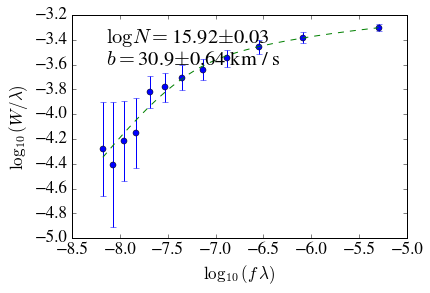

In [73]:
ltac.cog_plot(cog_dict)

### Using linetools AbsComponent

In [74]:
from linetools.isgm.abscomponent import AbsComponent

In [75]:
comp = AbsComponent.from_abslines(abslines)

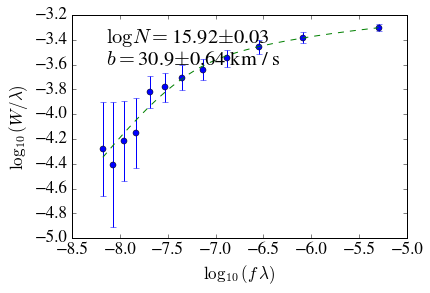

{'EW': <Quantity [ 0.04777595, 0.03598249, 0.05627415, 0.06489144, 0.13948252,
             0.15194019, 0.18311434, 0.21467479, 0.26812732, 0.33891577,
             0.4251579 , 0.60722176] Angstrom>,
 'b': <Quantity 30.878778595334552 km / s>,
 'f': array([ 0.0007231,  0.0009219,  0.001201 ,  0.001606 ,  0.002217 ,
         0.003185 ,  0.004816 ,  0.007803 ,  0.01395  ,  0.02901  ,
         0.07914  ,  0.4164   ]),
 'logN': 15.923829843356831,
 'parm': <single_cog_model(logN=15.923829843356831, b=30.878778595334552)>,
 'redEW': array([  5.20900246e-05,   3.91910870e-05,   6.12107095e-05,
          7.04604165e-05,   1.51094049e-04,   1.64042318e-04,
          1.96738859e-04,   2.28912360e-04,   2.82315659e-04,
          3.48486354e-04,   4.14496146e-04,   4.99495551e-04]),
 'sig_EW': <Quantity [ 0.01816817, 0.01816817, 0.01816817, 0.01816817, 0.01816817,
             0.01816817, 0.01817117, 0.01817117, 0.01817117, 0.01817117,
             0.01816817, 0.01817117] Angstrom>,
 'sig_b': <Qu

In [76]:
comp.cog(show_plot=True)

----

## Tests

In [ ]:
lya = AbsLine(1215.6700*u.AA)
lya.attrib['N'] = 10.**(13.6)/u.cm**2
lya.attrib['b'] = 30 * u.km/u.s

In [ ]:
par = [13.6, 0., 30*1e5, 1215.67*1e-8, f_jk, gamma_k.value]
ltav.voigt_tau(1215.670*1e-8, par)

In [ ]:
(const.k_B * 1e4*u.Kelvin).to('eV')

In [122]:
lam35 = 4.5 * 911.7
lam_100 = lam35-100
z_edge = lam_100/911.7 - 1

In [123]:
z_edge

3.390314796533948

In [125]:
np.exp(0.25)

1.2840254166877414